In [ ]:
import tensorflow as tf
import tensorflow_datasets as tfds
import numpy as np
import time
import matplotlib.pyplot as plt
train,test = tfds.load("mnist",split=["train","test"],shuffle_files=True,as_supervised=True)

local data directory. If you'd instead prefer to read directly from our public
GCS bucket (recommended if you're running on GCP), you can instead pass
`try_gcs=True` to `tfds.load` or set `data_dir=gs://tfds-data/datasets`.



Dl Completed...:   0%|          | 0/4 [00:00<?, ? file/s]


Dataset mnist downloaded and prepared to /root/tensorflow_datasets/mnist/3.0.1. Subsequent calls will reuse this data.


(28, 28, 1)


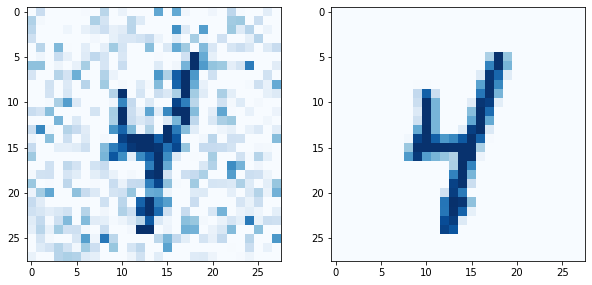

In [ ]:
# Let's have a look at the images
for a,b in train.take(1):
    b = a
    print(a.shape)
    a = tf.cast(a,tf.float32)
    a = a/255
    a += tf.random.normal(a.shape,stddev=0.25)
    a= tf.clip_by_value(a,0,1)
    f, imgs = plt.subplots(1,2,figsize=(10,10))
    imgs[0].imshow(a.numpy().reshape(28,28),cmap="Blues")
    imgs[1].imshow(b.numpy().reshape(28,28),cmap="Blues")

In [ ]:
# our data pipeline, adding the noize + standard stuff
def pipeline(ds):
  ds =  ds.map(lambda input , label: (tf.cast(input,tf.float32)/256,label))
  ds = ds.map(lambda i,l:(tf.clip_by_value(i+tf.random.normal(i.shape,stddev=.25),0,1),i))
  ds = ds.batch(128)
  ds = ds.shuffle(1000)
  return ds.prefetch(20)
train_ds, test_ds = pipeline(train), pipeline(test)

In [ ]:
# Here is our Encoder, it's pretty basic DeepCNN stuff
class Encoder(tf.keras.Model):

    def __init__(self):
        super(Encoder, self).__init__()
        self.lys = [# block 1
                       tf.keras.layers.Conv2D(32,3,padding="same",name='conv_1'),
                       tf.keras.layers.BatchNormalization(name='bn_1'),
                       tf.nn.leaky_relu,
                  
                       # block 2
                       tf.keras.layers.Conv2D(64,3,2,padding="same",name='conv_2'),
                       tf.keras.layers.BatchNormalization(name='bn_2'),
                       tf.nn.leaky_relu,

                       # block 3
                       tf.keras.layers.Conv2D(64,3,2,padding="same",name='conv_3'),
                       tf.keras.layers.BatchNormalization(name='bn_3'),
                       tf.nn.leaky_relu,

                       # block 4
                       tf.keras.layers.Conv2D(64,3,padding="same",name='conv_4'),
                       tf.keras.layers.BatchNormalization(name='bn_4'),
                       tf.nn.leaky_relu,
                    

                       # flatten
                       tf.keras.layers.GlobalAveragePooling2D(),
                       #applying bottleneck
                       tf.keras.layers.Dense(3)]

    def call(self,data):
        x = data
        for l in self.lys:
          x = l(x)
        return x

In [ ]:
class Decoder(tf.keras.Model):

    def __init__(self):
        super(Decoder, self).__init__()
        self.lys = [# reshaping
                       tf.keras.layers.Dense(7*7*64 ,name='input_layer'),
                       tf.keras.layers.Reshape((7,7,64), name='Reshape_Layer'),
                       

                       # block 1
                       tf.keras.layers.Conv2DTranspose(64,3,padding="same",name='conv_1'),
                       tf.keras.layers.BatchNormalization(name='bn_1'),
                       tf.nn.leaky_relu,

                       # block 2
                       tf.keras.layers.Conv2DTranspose(64,3,2,padding="same",name='conv_2'),
                       tf.keras.layers.BatchNormalization(name='bn_2'),
                       tf.nn.leaky_relu,

                       # block 3
                       tf.keras.layers.Conv2DTranspose(32,3,2,padding="same",name='conv_3'),
                       tf.keras.layers.BatchNormalization(name='bn_3'),
                       tf.nn.leaky_relu,

                       # block 4
                       tf.keras.layers.Conv2D(1,3,padding="same",activation='sigmoid',name='output_layer')]

    def call(self,data):
        x = data
        for l in self.lys:
          x = l(x)
        return x

In [ ]:
class AutoEncoder(tf.keras.Model):
    def __init__(self):
        super(AutoEncoder, self).__init__()
        self.encoder = Encoder()
        self.decoder = Decoder()

    @tf.function
    def call(self,data):
      x = self.encoder(data)
      x = self.decoder(x)
      return x

0.500051 0.4999404


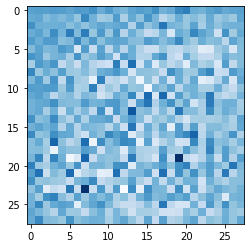

Model: "auto_encoder_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 encoder_2 (Encoder)         multiple                  93763     
                                                                 
 decoder_2 (Decoder)         multiple                  105793    
                                                                 
Total params: 199,556
Trainable params: 198,788
Non-trainable params: 768
_________________________________________________________________


In [ ]:
# Let's have a look at our an output image of our model and the layer summarys
M = AutoEncoder()
for a,b in train_ds.take(1):
  val = M(a)
  i = val.numpy()[0]
  plt.imshow(i.reshape((28,28)),cmap="Blues")
  print(i.max(),i.min())

plt.show()
M.summary()

In [ ]:
M.encoder.summary()

Model: "encoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv_1 (Conv2D)             multiple                  320       
                                                                 
 bn_1 (BatchNormalization)   multiple                  128       
                                                                 
 conv_2 (Conv2D)             multiple                  18496     
                                                                 
 bn_2 (BatchNormalization)   multiple                  256       
                                                                 
 conv_3 (Conv2D)             multiple                  36928     
                                                                 
 bn_3 (BatchNormalization)   multiple                  256       
                                                                 
 conv_4 (Conv2D)             multiple                  3692

In [ ]:
M.decoder.summary()

Model: "decoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_layer (Dense)         multiple                  12544     
                                                                 
 Reshape_Layer (Reshape)     multiple                  0         
                                                                 
 conv_1 (Conv2DTranspose)    multiple                  36928     
                                                                 
 bn_1 (BatchNormalization)   multiple                  256       
                                                                 
 conv_2 (Conv2DTranspose)    multiple                  36928     
                                                                 
 bn_2 (BatchNormalization)   multiple                  256       
                                                                 
 conv_3 (Conv2DTranspose)    multiple                  1846

In [ ]:
# Here are our train and test functions, which are the same as pretty much always, we just set the accuracy as 1-loss
def train_step(model, input, target, loss_function, optimizer):

  #create gradient tape to keep track of everything in the forward pass
  with tf.GradientTape() as tape:

    #model forward
    prediction = model(input)
    #get loss
    loss = loss_function(target, prediction)
    
  #get gradients
  gradients = tape.gradient(loss, model.trainable_weights)
  #apply gradients
  optimizer.apply_gradients(zip(gradients, model.trainable_weights))
  # #profit
  return loss

def test(model, test_data, loss_function):
  # test over complete test data

  test_accuracy_aggregator = []
  test_loss_aggregator = []

  for (input, target) in test_data:
    prediction = model(input)
    sample_test_loss = loss_function(target, prediction)
    sample_test_accuracy =  1 - sample_test_loss
    test_loss_aggregator.append(sample_test_loss.numpy())
    test_accuracy_aggregator.append(np.mean(sample_test_accuracy))

  test_loss = tf.reduce_mean(test_loss_aggregator)
  test_accuracy = tf.reduce_mean(test_accuracy_aggregator)

  return test_loss, test_accuracy

Our model had a accuracy of 0.76892322 at pre-testing

Finished epoch 0, it took 0 minutes, 43 seconds
Accuracy: 0.94875914, Loss 0.06308835



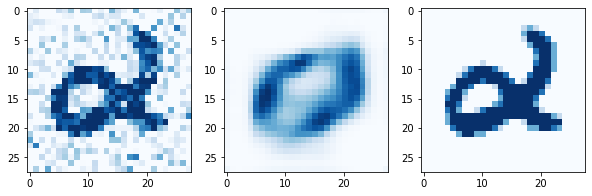

Finished epoch 1, it took 0 minutes, 44 seconds
Accuracy: 0.95565093, Loss 0.04666673



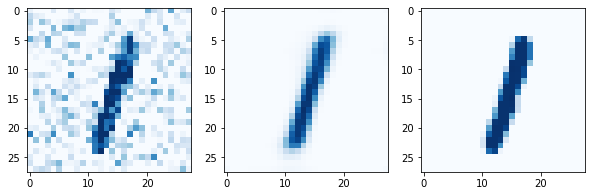

Finished epoch 2, it took 0 minutes, 38 seconds
Accuracy: 0.95690471, Loss 0.04353985



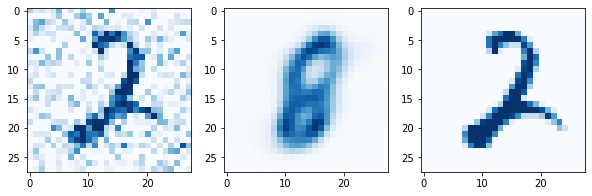

Finished epoch 3, it took 0 minutes, 46 seconds
Accuracy: 0.95899975, Loss 0.04148084



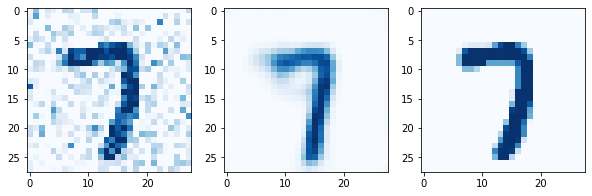

Finished epoch 4, it took 1 minutes, 27 seconds
Accuracy: 0.96036339, Loss 0.04019557



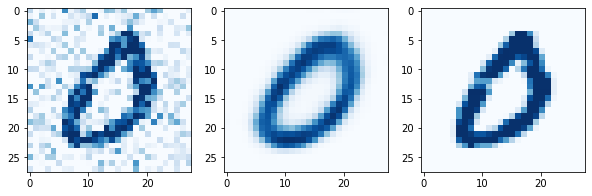

Finished epoch 5, it took 0 minutes, 34 seconds
Accuracy: 0.96110022, Loss 0.03926285



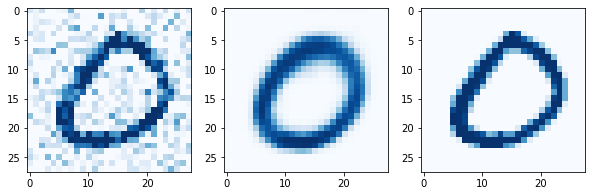

Finished epoch 6, it took 0 minutes, 35 seconds
Accuracy: 0.96171629, Loss 0.03860645



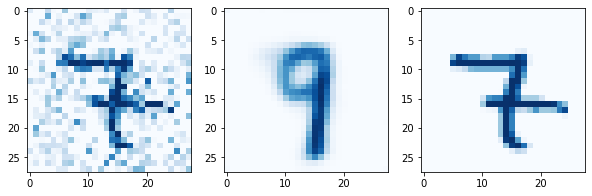

Finished epoch 7, it took 0 minutes, 33 seconds
Accuracy: 0.96184170, Loss 0.03804951



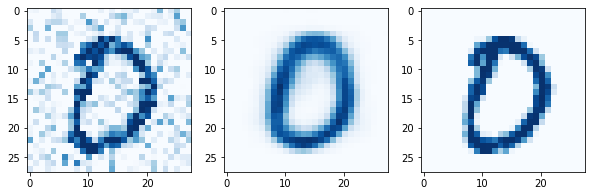

Finished epoch 8, it took 0 minutes, 33 seconds
Accuracy: 0.96272171, Loss 0.03764786



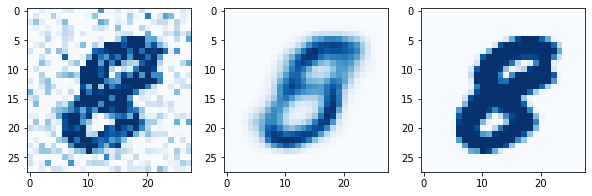

Finished epoch 9, it took 0 minutes, 34 seconds
Accuracy: 0.96313441, Loss 0.03714623



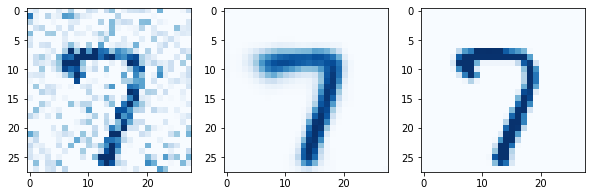

In [ ]:
# This part is the same as pretty much always, we just included time measurerments of the epochs and the plotting of a result image after every epoch
tf.keras.backend.clear_session()

# define hyperparams
learning_rate = tf.constant(0.001, dtype=tf.float64) # A smaller learning rate prooved to be more useful
num_epochs = 10
model = AutoEncoder()
loss_func = tf.keras.losses.MeanSquaredError()
optimizer = tf.optimizers.Adam(learning_rate)        # Adam yielded the most stable accuracies from all tested optimizers

# arrays for later visualization
# initial tests before training
train_losses = np.empty(0)

test_loss, test_acc = test(model, test_ds, loss_func)
test_losses = np.array([test_loss])
test_accuracies = np.array([test_acc])

# model performance before training
train_loss, _ = test(model, train_ds, loss_func)
train_losses = np.append(train_losses, train_loss)
start_time = time.time()
# training of our model
print(f"Our model had a accuracy of {test_accuracies[-1]:.8f} at pre-testing\n")
for epoch in range(num_epochs):
    

    epoch_loss_agg = np.empty(0)
    for input, target in train_ds:
        train_loss = train_step(model, input, target, loss_func, optimizer)
        epoch_loss_agg = np.append(epoch_loss_agg, train_loss)

    train_losses = np.append(train_losses, tf.reduce_mean(epoch_loss_agg))

    test_loss, test_acc = test(model, test_ds, loss_func)
    test_losses = np.append(test_losses, test_loss)
    test_accuracies = np.append(test_accuracies, test_acc)
    used_time = np.round(time.time()-start_time)
    print(f"Finished epoch {epoch}, it took {int(used_time //60)} minutes, {int(used_time%60)} seconds")
    print(f'Accuracy: {test_accuracies[-1]:.8f}, Loss {train_losses[-1]:.8f}\n')
    start_time = time.time()

    # Here we plot the noizy input, the recreated image of the deocoder and the target image
    for noisy_batch,real_img in test_ds.take(1):

      real_imgage = real_img.numpy()[0]

      denoized_image = model(noisy_batch).numpy()[0]
      noizy= noisy_batch.numpy()[0]
      f, imgs = plt.subplots(1,3,figsize=(10,10))
      imgs[0].imshow(noizy.reshape(28,28),cmap="Blues")
      imgs[1].imshow(denoized_image.reshape(28,28),cmap="Blues")
      imgs[2].imshow(real_imgage.reshape(28,28),cmap="Blues")
      plt.show()

In our datapipeline we dropped the target information, so which image represents which number. But we need this information back, to nicely analyze the latentspace. Therefore we thought, that a standard mnist classifer would be useful. 

Because we could not find an already trained one to import we just copied the sequential api example from the tf homepage to quickly train us on. 

In [ ]:
(classifier_ds_train, classifier_ds_test), ds_info = tfds.load(
    'mnist',
    split=['train', 'test'],
    shuffle_files=True,
    as_supervised=True,
    with_info=True,
)
def normalize_img(image, label):
  """Normalizes images: `uint8` -> `float32`."""
  return tf.cast(image, tf.float32) / 255., label
classifier_ds_train = classifier_ds_train.map(
    normalize_img, num_parallel_calls=tf.data.AUTOTUNE)
classifier_ds_train = classifier_ds_train.cache()
classifier_ds_train = classifier_ds_train.shuffle(ds_info.splits['train'].num_examples)
classifier_ds_train = classifier_ds_train.batch(128)
classifier_ds_train = classifier_ds_train.prefetch(tf.data.AUTOTUNE)

classifier_ds_test = classifier_ds_test.map(
    normalize_img, num_parallel_calls=tf.data.AUTOTUNE)
classifier_ds_test = classifier_ds_test.batch(128)
classifier_ds_test = classifier_ds_test.cache()
classifier_ds_test = classifier_ds_test.prefetch(tf.data.AUTOTUNE)
                           
classifier = tf.keras.models.Sequential([
  tf.keras.layers.Flatten(input_shape=(28, 28)),
  tf.keras.layers.Dense(128, activation='relu'),
  tf.keras.layers.Dense(128, activation='relu'),
  tf.keras.layers.Dense(10)
])
classifier.compile(
    optimizer=tf.keras.optimizers.Adam(0.001),
    loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
    metrics=[tf.keras.metrics.SparseCategoricalAccuracy()],
)

classifier.fit(
    classifier_ds_train,
    epochs=6,
    validation_data=classifier_ds_test,
)

Epoch 1/6
469/469 [==============================] - 15s 9ms/step - loss: 0.3155 - sparse_categorical_accuracy: 0.9112 - val_loss: 0.1531 - val_sparse_categorical_accuracy: 0.9544
Epoch 2/6
469/469 [==============================] - 2s 5ms/step - loss: 0.1271 - sparse_categorical_accuracy: 0.9626 - val_loss: 0.1061 - val_sparse_categorical_accuracy: 0.9674
Epoch 3/6
469/469 [==============================] - 2s 5ms/step - loss: 0.0871 - sparse_categorical_accuracy: 0.9732 - val_loss: 0.0853 - val_sparse_categorical_accuracy: 0.9742
Epoch 4/6
469/469 [==============================] - 2s 5ms/step - loss: 0.0656 - sparse_categorical_accuracy: 0.9797 - val_loss: 0.0787 - val_sparse_categorical_accuracy: 0.9748
Epoch 5/6
469/469 [==============================] - 2s 4ms/step - loss: 0.0521 - sparse_categorical_accuracy: 0.9837 - val_loss: 0.0735 - val_sparse_categorical_accuracy: 0.9774
Epoch 6/6
469/469 [==============================] - 2s 5ms/step - loss: 0.0414 - sparse_categorical_acc

Since we have trained us a classifer now, we can have look how good our Decoder is.

In [ ]:
m = []
for noisy_batch,real_img in train_ds:
  m.append(np.mean(np.argmax(classifier(real_img).numpy(),axis=-1) == np.argmax(classifier(noisy_batch).numpy(),axis=-1) ))
np.mean(m)

0.8185800906183369

So altough the loss of our Modell is quite small, the model only recreaces ~80% of the images right, which is quite surprisingly low. Maybe our latent space of 3 was to small.

So let's have a look at which numbers might be switched up.

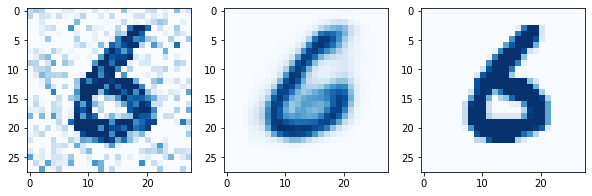

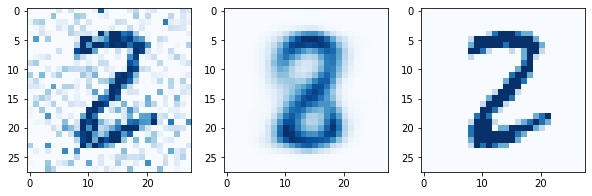

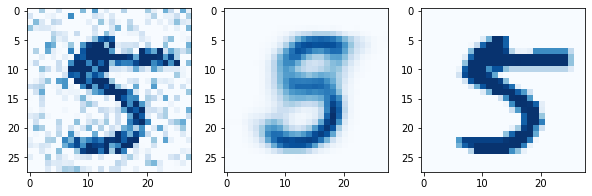

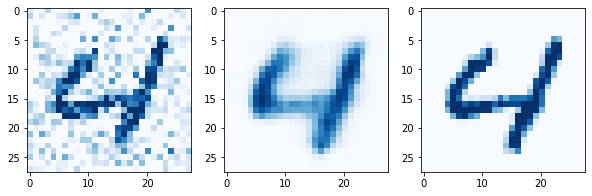

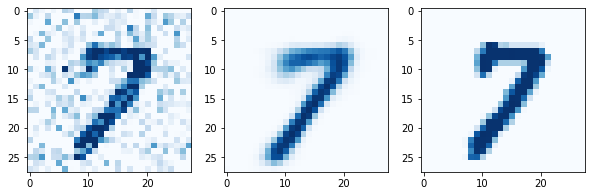

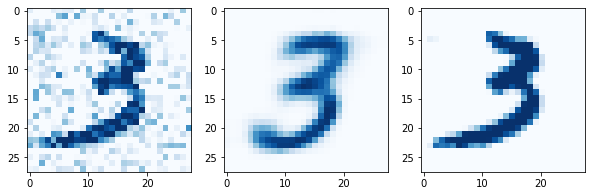

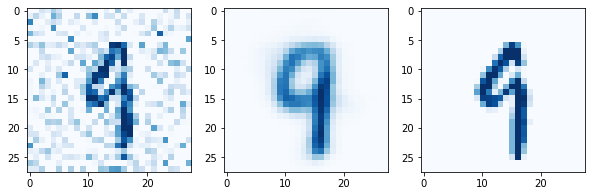

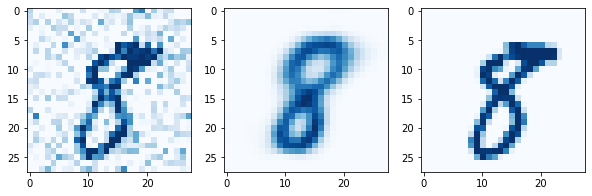

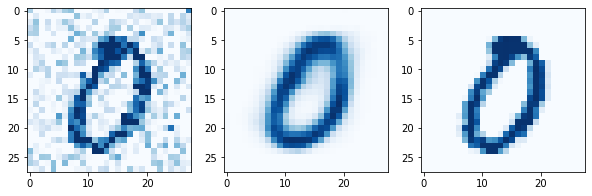

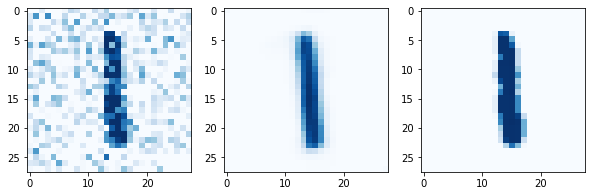

In [ ]:
import matplotlib.pyplot as plt
numbers = np.zeros(10,dtype=bool)
for noisy_batch,real_img in test_ds.take(1):
  present_numbers= np.argmax(classifier(real_img).numpy(),axis=-1)
  if len(np.unique(present_numbers))!=10:
    print("error")
  real_imgages = real_img.numpy()
  denoized_images = model(noisy_batch).numpy()
  indeces = []
  for pos,i in enumerate(present_numbers):
    if numbers[i]==0:
      numbers[i]=1
      indeces.append(pos)
  noizy = noisy_batch.numpy()
  for i in indeces:
    f, imgs = plt.subplots(1,3,figsize=(10,10))
    imgs[0].imshow(noizy[i].reshape(28,28),cmap="Blues")
    imgs[1].imshow(denoized_images[i].reshape(28,28),cmap="Blues")
    imgs[2].imshow(real_imgages[i].reshape(28,28),cmap="Blues")

We can see that a 2 with a bit of unfortunate noise became a 8. All the others are quite good though-

Let's have a lok at the latent space, maybe 2's and 8's are intertwined.

In [ ]:
x_dots, y_dots,z_dots, group = [],[],[],[]

encoder = model.encoder

for noisy_batch,real_img in train_ds.take(10):
  for y in np.argmax(classifier(real_img).numpy(),axis=-1):
      group.append(y)
  for ax1,ax2,ax3 in encoder(noisy_batch).numpy():
    x_dots.append(ax1); y_dots.append(ax2); z_dots.append(ax3)

x_dots = np.array(x_dots); y_dots= np.array(y_dots); z_dots = np.array(z_dots); group = np.array(group)

10
10


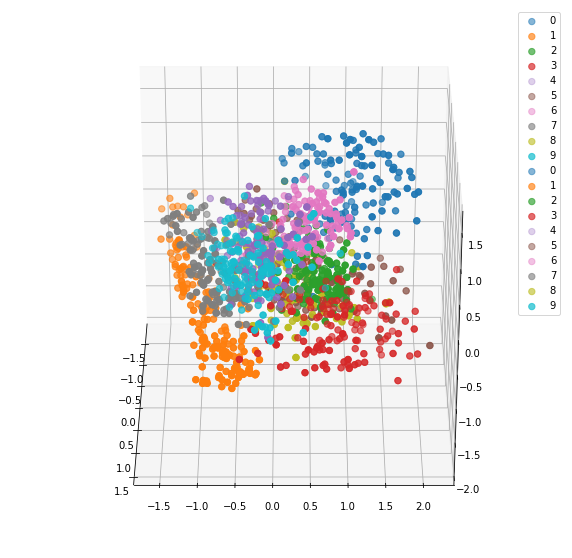

In [ ]:
from IPython.display import HTML
import matplotlib.animation as animation
import sys
    
fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(projection='3d')
c = 0
def init():
  glo
    print(len(np.unique(group)))
    for g in np.unique(group):
        i = np.where(group == g)
        ax.scatter(x_dots[i], y_dots[i],z_dots[i], label=g,s=40)
    return fig,        

def update(frame):
    ax.view_init(30,frame)
    if frame==360:
      ax.legend()
    return fig,
ani = animation.FuncAnimation(fig, update, frames=np.linspace(0, 360, 200),
                    init_func=init, blit=True)

HTML(ani.to_html5_video())

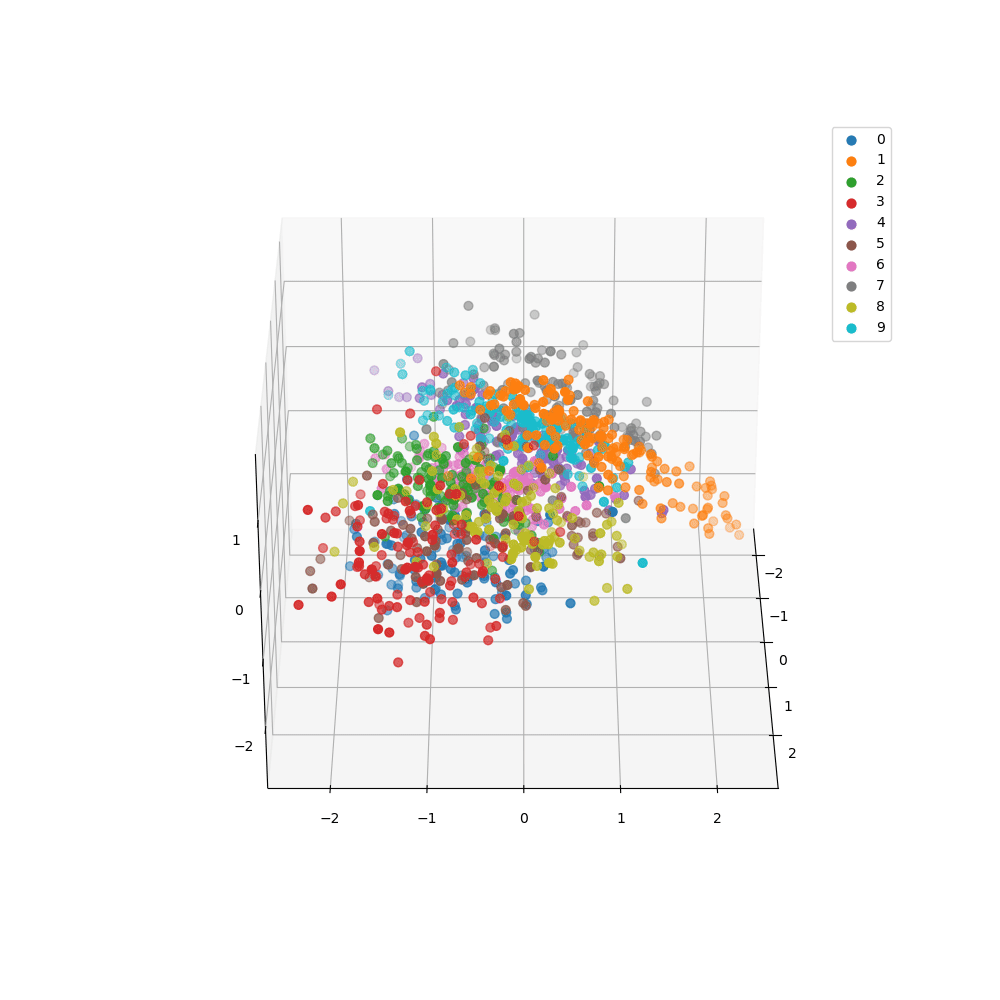

In [ ]:
# Here a nicer video of old data
from IPython.display import Image
Image(open('/content/drive/MyDrive/Tensorflow/week8/test.png','rb').read())

So as we can see, there is some grouping in the latent space, but still overlaping and empy spaces in between.

1's, 0's, 7's and 3's have there little distinct areas, this is probably because there are more different ususally then the rest.

Just for visibility let's have a look at only two the zeros and ones.
We will also chose two points and then start interpolinating (marked by the line)

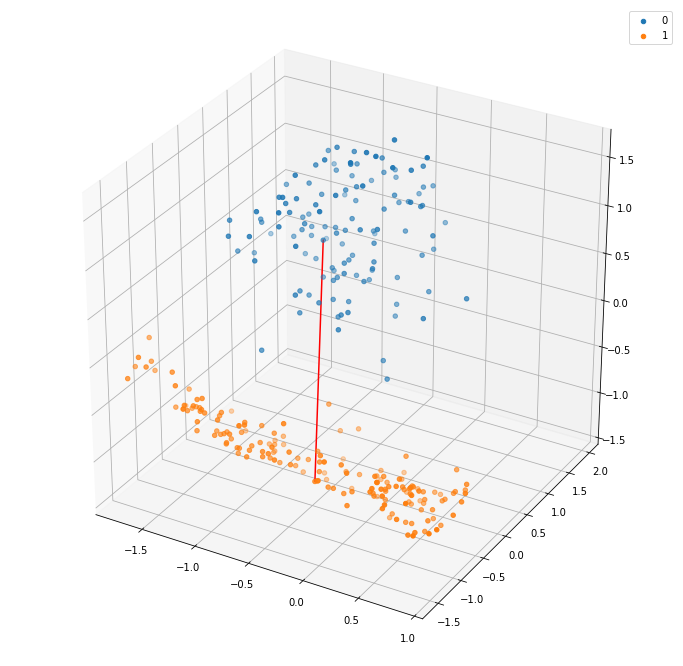

In [ ]:
fig = plt.figure(figsize=(12, 12))
ax = fig.add_subplot(projection='3d')

imgs = []
for g in np.unique(group)[:2]:
    i = np.where(group == g)
    ax.scatter(x_dots[i], y_dots[i],z_dots [i], label=g)
    imgs.append(np.array([x_dots[i], y_dots[i],z_dots [i]]))
data = np.array([imgs[0][:,0],imgs[1][:,0]])
ax.plot(data[:,0],data[:,1],data[:,2],c="r")
ax.legend()
plt.show()

Let's have a look at the interpolination:

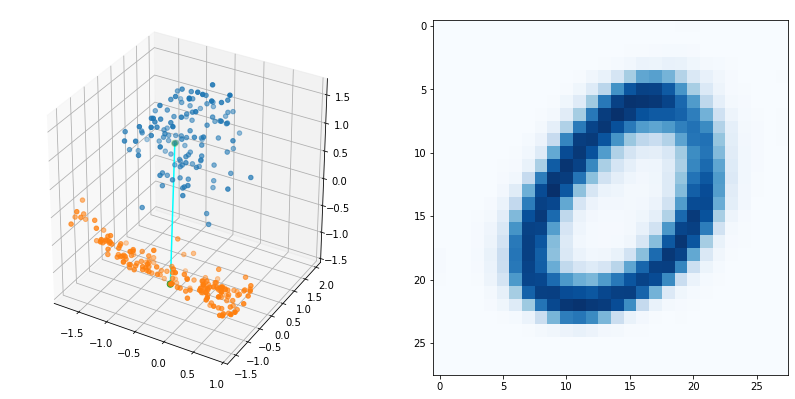

The argmax: 0
The full array:
[ 14.422762   -10.926791     2.1436381   -7.319798    -6.6403103
  -5.607405    -0.47200274  -2.8917925   -5.6673617   -0.24350022] 


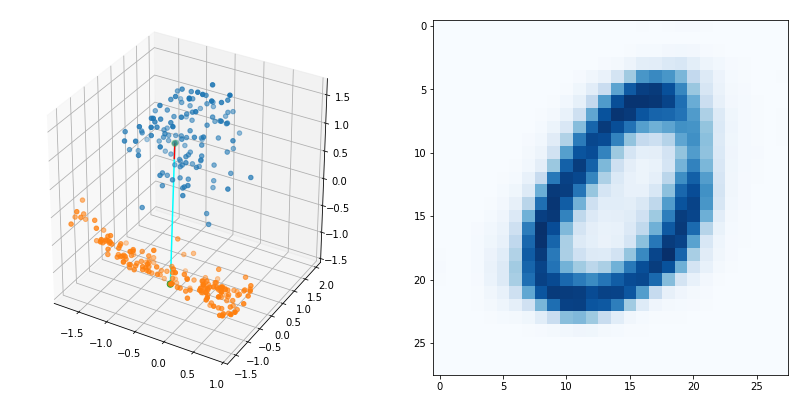

The argmax: 0
The full array:
[10.846778   -9.996008    3.0363488  -5.358212   -6.154438   -4.843926
  0.27546322 -3.8914762  -3.8369043  -1.9179447 ] 


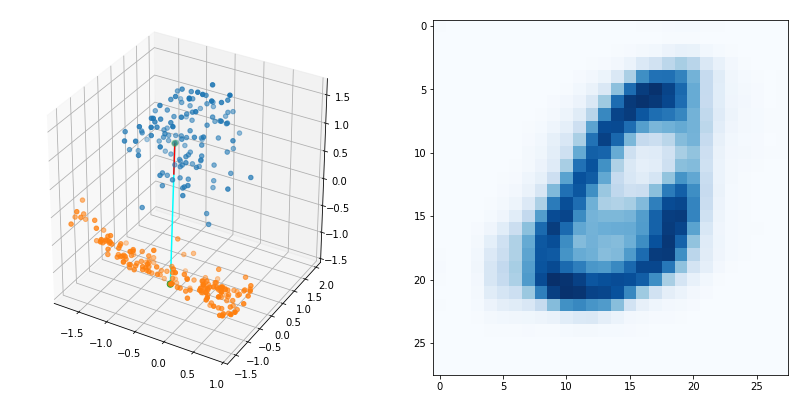

The argmax: 0
The full array:
[ 3.748945  -8.508885   2.647535  -3.1937356 -4.9936833 -2.3082938
  2.916164  -5.15066   -2.3178809 -5.8462276] 


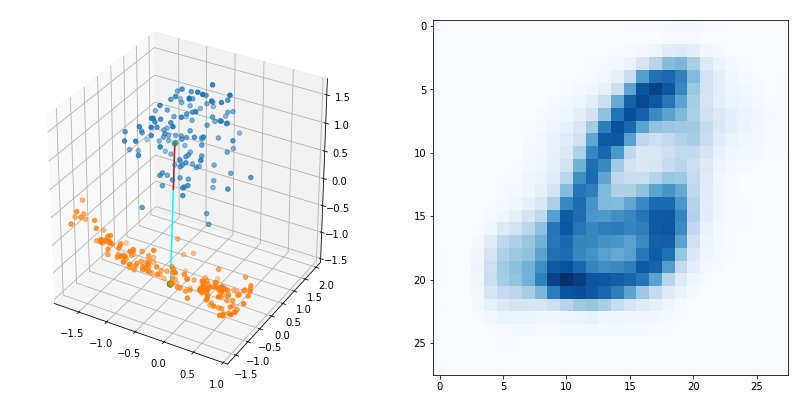

The argmax: 6
The full array:
[-0.07651211 -6.0054736   1.8601158  -1.7733991  -4.9676433   0.25390726
  4.03488    -5.2693315  -1.4744204  -8.332277  ] 


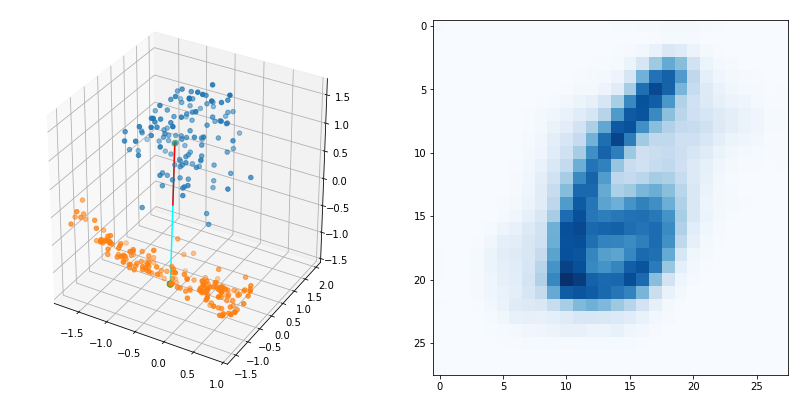

The argmax: 6
The full array:
[ 0.567704   -4.935722   -0.578112   -3.5004573  -3.7057333  -0.26927733
  5.4444475  -5.2644525   0.3751835  -6.4804077 ] 


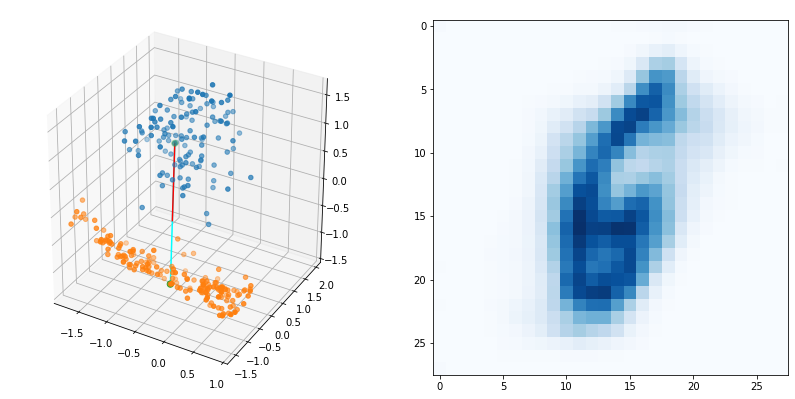

The argmax: 6
The full array:
[ 0.6520028 -5.0531793 -1.9981078 -3.853153  -1.0057689 -2.3837156
  2.63559   -3.794664   2.371609  -1.7122457] 


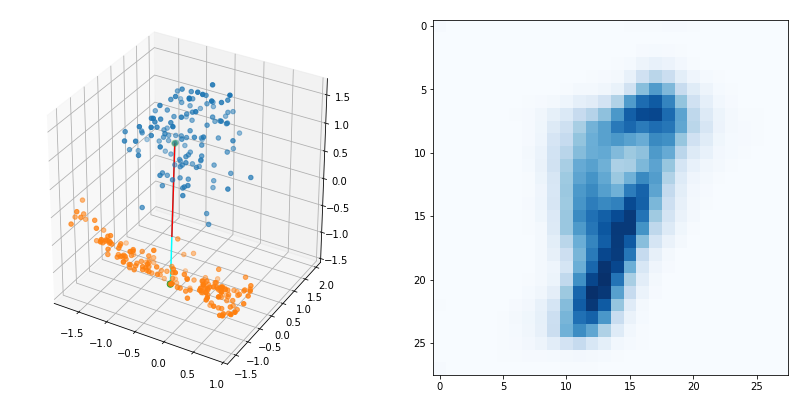

The argmax: 8
The full array:
[-1.559736   -1.9340146  -3.3580582  -1.8445786  -0.92188346 -3.953555
 -4.1744432   0.59121394  3.0528042   2.411168  ] 


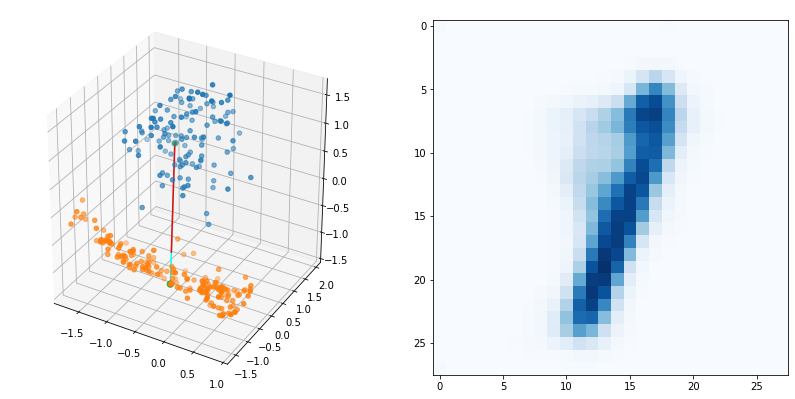

The argmax: 1
The full array:
[-2.6833642   3.5987153  -3.2866971  -1.433371   -1.2081637  -5.660842
 -6.5975266   3.0749013   1.8954338   0.33477378] 


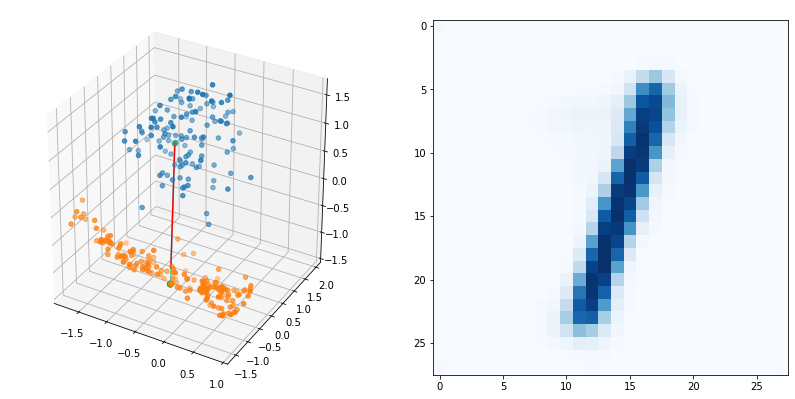

The argmax: 1
The full array:
[-3.7810042   8.451425   -2.178024   -1.7788355  -2.0318992  -5.003795
 -5.43906     3.9177322   0.24456593 -3.9361212 ] 


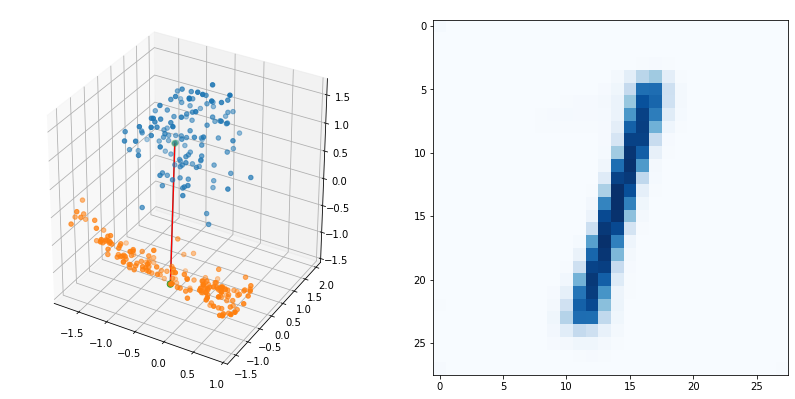

The argmax: 1
The full array:
[-3.802619    9.077447   -1.5070758  -2.4800093  -2.4233851  -3.931327
 -3.6638606   2.6165621   0.47630528 -5.1910524 ] 


In [ ]:
import scipy
img1,img2 = data[0],data[1]
functions = [scipy.interpolate.interp1d([0,9],list(c)) for c in zip(img1,img2)]
images = np.array([[functions[i](c)for i in range(3) ] for c in range(10)])
decoder = model.decoder
for img in images:
  fig = plt.figure(figsize=(14, 7))
  ax = fig.add_subplot(1,2,1,projection='3d')
  for w,l in enumerate(imgs):
    ax.scatter(l[0],l[1],l[2],label=w)
  ax.scatter(data[:,0],data[:,1],data[:,2],s=40)
  ax.plot(data[:,0],data[:,1],data[:,2],c="aqua")
  ax.plot([data[0,0],img[0]],[data[0,1],img[1]],[data[0,2],img[2]],c="r")
  
  img = decoder(tf.convert_to_tensor(img.reshape(1,3))).numpy()
  
  ax = fig.add_subplot(1,2,2)
  ax.imshow(img.reshape(28,28),cmap='Blues')
  

  plt.show()
  classified_img = classifier(img).numpy()[0]
  print(f"The argmax: {np.argmax(classified_img)}\nThe full array:\n{classified_img} ")

As we traverse the center of our latent space, we can see that our 0 becomes a 6 then a 9 and finally the 1.

The small gradually changes are pretty intersting. Especially from the 9 to the one.